# Interactive Dashboard and Streaming of Data
The last point of our project concerns the dataframe representing the number of cars associated to a base station at a given time, which is obtained in [notebook 2](/2-Metrics_groupby.ipynb) and saved as `Nick_df.csv`. The goal is to show traffic congestions in Koln by displaying, through a colormap, the data. This is achived following two approaches:
1. Building an interactive dashboard
2. Generating a stream of data

In [2]:
from dask.distributed import Client, SSHCluster
cluster = SSHCluster(
     ["10.67.22.41", "10.67.22.41", "10.67.22.145", "10.67.22.146", '10.67.22.160', '10.67.22.253'],
     worker_options={"nthreads": 1, 'n_workers':4},
     scheduler_options={"dashboard_address": ":8402"}
)

client = Client(cluster)
client

distributed.deploy.ssh - INFO - distributed.http.proxy - INFO - To route to workers diagnostics web server please install jupyter-server-proxy: python -m pip install jupyter-server-proxy
distributed.deploy.ssh - INFO - distributed.scheduler - INFO - Clear task state
distributed.deploy.ssh - INFO - distributed.scheduler - INFO -   Scheduler at:   tcp://10.67.22.41:36813
distributed.deploy.ssh - INFO - distributed.nanny - INFO -         Start Nanny at: 'tcp://10.67.22.146:42337'
distributed.deploy.ssh - INFO - distributed.nanny - INFO -         Start Nanny at: 'tcp://10.67.22.145:42677'
distributed.deploy.ssh - INFO - distributed.nanny - INFO -         Start Nanny at: 'tcp://10.67.22.41:37235'
distributed.deploy.ssh - INFO - distributed.nanny - INFO -         Start Nanny at: 'tcp://10.67.22.146:32891'
distributed.deploy.ssh - INFO - distributed.nanny - INFO -         Start Nanny at: 'tcp://10.67.22.145:35787'
distributed.deploy.ssh - INFO - distributed.nanny - INFO -         Start Nanny 

distributed.deploy.ssh - INFO - distributed.worker - INFO - Waiting to connect to:    tcp://10.67.22.41:36813
distributed.deploy.ssh - INFO - distributed.worker - INFO - -------------------------------------------------
distributed.deploy.ssh - INFO - distributed.worker - INFO -               Threads:                          1
distributed.deploy.ssh - INFO - distributed.worker - INFO -                Memory:                   1.94 GiB
distributed.deploy.ssh - INFO - distributed.worker - INFO -       Local Directory: /root/dask-worker-space/worker-4gj3347q
distributed.deploy.ssh - INFO - distributed.worker - INFO - -------------------------------------------------
distributed.deploy.ssh - INFO - distributed.worker - INFO -       Start worker at:   tcp://10.67.22.253:35867
distributed.deploy.ssh - INFO - distributed.worker - INFO -          Listening to:   tcp://10.67.22.253:35867
distributed.deploy.ssh - INFO - distributed.worker - INFO -          dashboard at:         10.67.22.253:372

distributed.deploy.ssh - INFO - distributed.worker - INFO - Waiting to connect to:    tcp://10.67.22.41:36813
distributed.deploy.ssh - INFO - distributed.worker - INFO - -------------------------------------------------
distributed.deploy.ssh - INFO - distributed.worker - INFO -               Threads:                          1
distributed.deploy.ssh - INFO - distributed.worker - INFO -                Memory:                   1.94 GiB
distributed.deploy.ssh - INFO - distributed.worker - INFO -       Local Directory: /root/dask-worker-space/worker-hjq6itwg
distributed.deploy.ssh - INFO - distributed.worker - INFO - -------------------------------------------------
distributed.deploy.ssh - INFO - distributed.worker - INFO -       Start worker at:    tcp://10.67.22.41:33875


<Client: 'tcp://10.67.22.41:36813' processes=16 threads=16, memory=31.08 GiB>

In [3]:
import dask
import dask.bag as db
import dask.dataframe as dd
import re
import pandas as pd

from streamz import Stream
from streamz.dataframe import DataFrame, Random

import holoviews as hv
import hvplot.streamz  

from matplotlib import cm
import datetime

import panel as pn

# Import data and preprocessing

In [4]:
# number of connections to each BS at each time instant
dd_bs_connect = dd.read_csv('/dataNFS/Nick_df.csv', blocksize='0.5MB')

In [5]:
# map informations
upper, lower, right, left = pd.read_csv("/dataNFS/grid_params.csv", header=0)[['upper','lower', 'right','left']].values[0]

df_BS = pd.read_csv("/dataNFS/df_BS.csv", header=0)
df_grid = pd.read_csv("/dataNFS/df_grid.csv", header=0)

In [6]:
# convert time column to datetime format 
origin_time = '2022-07-13'

dd_bs_connect["time"] = dd_bs_connect["time"].apply(
    lambda x: pd.to_datetime(x, unit='s', origin=origin_time), meta=('time', 'datetime64[ns]')
)

dd_bs_connect = dd_bs_connect.persist()

,time,base_ID,n_cars
npartitions=228,,,
,datetime64[ns],int64,int64
,...,...,...
...,...,...,...
,...,...,...
,...,...,...


# Dashboard
An interactive dashboard is built using the Python libraries [Panel](https://panel.holoviz.org/) and [HoloViews](https://holoviews.org/). In the app it is possible to select a time window using 2 sliders (`Time of Day` and `Window Size`). Only when the slider `Update Plot` is set on "ON", the dataframe with the total number of connections to each BS in the selected time window is computed and the plot is updated. The computation time required is approximately 2 minutes. 

**Pay attention:** before changing the time window the slider `Update Plot` must be set on **"OFF"!** 

## Define dynamic plot 

In [7]:
# initialization
joined_car_per_base = pd.DataFrame({
    'x':[],
    'y':[],
    'base_ID':[],
    'n_cars': []
})

title= 'Number of connections to each BS'

In [8]:
# update plot function
def load_time(time_picker, window_size, update): 
    global joined_car_per_base
    global title
    
    if update=='ON':
        # convert input time interval to datetime format
        if time_picker[6:]=='PM':
            seconds = (int(time_picker[0:2])+12)*3600+int(time_picker[3:5])*60
        else: 
            seconds = int(time_picker[0:2])*3600+int(time_picker[3:5])*60
    
        time_start = pd.to_datetime(seconds, unit='s', origin=origin_time)
        time_end   = pd.to_datetime(seconds+window_size*3600, unit='s', origin=origin_time)
        
        # update title
        title= 'Number of connections to each BS from '+time_start.strftime("%I:%M %p")+' to '+time_end.strftime("%I:%M %p")
    
        # update plot dataframe
        df_sel = dd_bs_connect[dd_bs_connect['time'].between(time_start, time_end)].groupby('base_ID').sum().compute()
        joined_car_per_base = df_BS[['x', 'y', 'base_ID']].merge(
            df_sel, left_on='base_ID', right_on='base_ID',
            right_index=False, how='left'
        )

        joined_car_per_base.fillna(0, inplace=True) 
    
    return hv.Scatter(joined_car_per_base, kdims=['x'], vdims=['y', 'n_cars']).opts(color='n_cars', xlim=(left, right), ylim=(lower, upper), marker="triangle_pin", size=20, cmap = cm.get_cmap('RdYlGn').reversed(), colorbar=True, title=title)
    

## Input Sliders

In [9]:
pn.extension()

# list of possible hours
hours_of_day = [
    f"{hh:02d}:{mm:02d} {ap}" for ap in ["AM", "PM"] for hh in [12]+list(range(1, 12))
    for mm in range(0, 60, 30)
] + [f"{12:02d}:{00:02d} {'PM'}"]

del hours_of_day[0:2] # our data start from 01:00 AM

time_picker = pn.widgets.DiscreteSlider(name="Time of Day", options=hours_of_day, value="08:00 AM")
window_size = pn.widgets.IntSlider(name='Window Size (hours)', value=1, start=0, end=24)
update = pn.widgets.DiscreteSlider(name="Update Plot", options=['OFF', 'ON'], value='OFF')

# pn.Column(time_picker, window_size, update)

## App Deployment


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
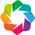

Row
    [0] WidgetBox
        [0] Markdown(str)
        [1] DiscreteSlider(name='Time of Day', options=['01:00 AM', '01:30 AM', ...], value='08:00 AM')
        [2] IntSlider(end=24, name='Window Size (hours)', value=1)
        [3] DiscreteSlider(name='Update Plot', options=['OFF', 'ON'], value='OFF')
    [1] HoloViews(DynamicMap)

In [10]:
hv.extension('bokeh')

Koln_map = hv.RGB.load_image('/dataNFS/real_map.png', bounds=(left, lower, right, upper))

connections_map = hv.DynamicMap(
    pn.bind(load_time, time_picker=time_picker, window_size=window_size, update=update)
)


app = pn.Row(
    pn.WidgetBox('### Select Time Window', time_picker, window_size, update), 
    (Koln_map*connections_map).opts(width=800, height=700, fontscale=1.2)
).servable()

app

In [3]:
#Cannot see the plot on Jupyter without running and without data..., 
#on Visual Studio Code it might work, in negative case, here's a preview

<img src="images/preview.png" width=1000/>

In [ ]:
# ! panel serve --show interactive_dashboard.ipynb 

# Streaming
Here we generate a stream of data from the dataset with the number of car connected to each BS at each time during the day, using the library [streamz](https://streamz.readthedocs.io/en/latest/), which supports a Dask integration. The data is streamed sequentially, streaming the information related to a specific time instant one next to the other. The input data from the stream are stored in a [streaming dataframe](https://streamz.readthedocs.io/en/latest/dataframes.html) and a time window is set to update the plot. The plot of the number of connections to each BS and of table with the input data are realized using again the library [HoloViews](https://holoviews.org/) with the [bokeh](https://bokeh.org/) extension.

## Definitions
- Function to generate the records
- Streaming object (stream output)
- Streaming dataframe (stream input)

In [1]:
time_i, time_f = dask.compute(dd_bs_connect['time'].min(), dd_bs_connect['time'].max())
time_i += datetime.timedelta(seconds=10000)
time = time_i

# generate record as pandas, according to time
def emit_rec():
    global time    
    
    record = dd_bs_connect[dd_bs_connect['time']==time].compute()
    
    time += datetime.timedelta(seconds=1)
    return record

In [2]:
print('Initial time:', time_i.strftime("%H:%M:%S"))
print('Final time:', time_f.strftime("%H:%M:%S"))

In [ ]:
# stream with streamz
source = Stream()
source.scatter()   

# type(source.scatter())

In [ ]:
# streaming dataframe
example = {
    'time': [pd.to_datetime(1, unit='s', origin='2022-07-01')],
    'base_ID': [1],
    'n_cars': [1]
}

sdf = DataFrame(stream=source, example=example)

In [ ]:
sdf.example.dtypes

## Processing of the streaming dataframe 

In [ ]:
sdf_occ = sdf.set_index('time').window(value='5s')[['base_ID', 'n_cars']].groupby('base_ID').mean() 

sdf_occ['x'] = df_BS.x
sdf_occ['y'] = df_BS.y

sdf_occ

## Dynamic plots

### Average number of connections in 5s

In [ ]:
heat_map = (
    sdf_occ.hvplot(kind='scatter', x='x', y='y', c='n_cars')
    .opts(xlim=(left, right), ylim=(lower, upper), marker="triangle_pin", size=20, cmap = cm.get_cmap('RdYlGn').reversed())
)

#origin_time = time - datetime.timedelta(seconds=5)
title = 'Number of connections to each BS'

(Koln_map*heat_map).opts(width=800, height=700, title=title, fontscale=1.2)


### Average energy amount in 5s
Given a total amount of energy (in our case 1000 in arbitrary units), the energy is split out across the BS proportionally to the number of cars connected on average to each.

In [ ]:
def energy_repartition(sdf_nconn):
    tot_energy = 1000
    tot_conn = sdf_nconn.sum()
    return sdf_nconn/tot_conn*tot_energy

In [ ]:
sdf_occ = sdf_occ.assign(energy=energy_repartition(sdf_occ.n_cars))

energy_map = (
    sdf_occ.hvplot(kind='scatter', x='x', y='y', c='energy')
    .opts(xlim=(left, right), ylim=(lower, upper), marker="triangle_pin", size=20, cmap = cm.get_cmap('RdYlGn').reversed())
)

title='Energy repartition'

(Koln_map*energy_map).opts(width=800, height=700, title=title, fontscale=1.2)


### Table of data in the selected window


In [ ]:
sdf_occ.hvplot(kind='table', columns=['base_ID', 'n_cars', 'x', 'y', 'energy'], width=500)

## Generate the stream

In [ ]:
from tornado import gen
from tornado.ioloop import IOLoop

async def f():
    while time<=time_f:
        # await gen.sleep(0.100)
        record = emit_rec()
        source.emit(record, asynchronous=True)
        
IOLoop.current().add_callback(f)

In [ ]:
# client.restart()
# ! jupyter nbconvert --clear-output --inplace 4-Dashboard_and_streaming.ipynb